In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_theme(style="darkgrid", palette="pastel")

In [4]:
rl_kpis = pd.read_csv("/root/projects/ci_anomaly_detection/data/turkcell/final_preprocessed_df_train.csv")

In [5]:
rl_kpis['datetime']=pd.to_datetime(rl_kpis['datetime'])

In [6]:
df_labels = rl_kpis[["datetime", "site_id", "mlid"]]
df_labels.head()

,datetime,site_id,mlid
0,2018-12-31,RL_;ABDV,A0BE
1,2018-12-31,RL_;ABDV,A0BI
2,2018-12-31,RL_;ABDV,A5AB
3,2018-12-31,RL_;ABDV,A8CQ
4,2018-12-31,RL_;ABDV,A8DQ


In [7]:
prediction_interval = 5

for i in range(prediction_interval):
  df_labels[f"T+{i+1}"] = df_labels["datetime"] + pd.DateOffset(days=i+1)
df_labels.head()

/tmp/ipykernel_23070/3134115453.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_labels[f"T+{i+1}"] = df_labels["datetime"] + pd.DateOffset(days=i+1)
/tmp/ipykernel_23070/3134115453.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_labels[f"T+{i+1}"] = df_labels["datetime"] + pd.DateOffset(days=i+1)
/tmp/ipykernel_23070/3134115453.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

,datetime,site_id,mlid,T+1,T+2,T+3,T+4,T+5
0,2018-12-31,RL_;ABDV,A0BE,2019-01-01,2019-01-02,2019-01-03,2019-01-04,2019-01-05
1,2018-12-31,RL_;ABDV,A0BI,2019-01-01,2019-01-02,2019-01-03,2019-01-04,2019-01-05
2,2018-12-31,RL_;ABDV,A5AB,2019-01-01,2019-01-02,2019-01-03,2019-01-04,2019-01-05
3,2018-12-31,RL_;ABDV,A8CQ,2019-01-01,2019-01-02,2019-01-03,2019-01-04,2019-01-05
4,2018-12-31,RL_;ABDV,A8DQ,2019-01-01,2019-01-02,2019-01-03,2019-01-04,2019-01-05


In [8]:
rl_kpis_view = rl_kpis[["datetime", "site_id", "mlid", "rlf"]]
for i in range(prediction_interval):
  target_day_column_name = f"T+{i+1}"

  df_labels = df_labels.merge(rl_kpis_view, 
                  how = "left", 
                  left_on = ("site_id", "mlid", target_day_column_name),
                  right_on = ("site_id", "mlid", "datetime"),
                  suffixes = ("", "_y")
  )
  df_labels.rename(columns={"rlf": f"{target_day_column_name}_rlf"}, inplace=True)
df_labels.drop(columns=["datetime_y"], inplace=True)
df_labels.head()

,datetime,site_id,mlid,T+1,T+2,T+3,T+4,T+5,T+1_rlf,T+2_rlf,T+3_rlf,T+4_rlf,T+5_rlf
0,2018-12-31,RL_;ABDV,A0BE,2019-01-01,2019-01-02,2019-01-03,2019-01-04,2019-01-05,0.0,0.0,0.0,0.0,0.0
1,2018-12-31,RL_;ABDV,A0BI,2019-01-01,2019-01-02,2019-01-03,2019-01-04,2019-01-05,0.0,0.0,0.0,0.0,0.0
2,2018-12-31,RL_;ABDV,A5AB,2019-01-01,2019-01-02,2019-01-03,2019-01-04,2019-01-05,0.0,0.0,0.0,0.0,0.0
3,2018-12-31,RL_;ABDV,A8CQ,2019-01-01,2019-01-02,2019-01-03,2019-01-04,2019-01-05,0.0,0.0,0.0,0.0,0.0
4,2018-12-31,RL_;ABDV,A8DQ,2019-01-01,2019-01-02,2019-01-03,2019-01-04,2019-01-05,0.0,0.0,0.0,0.0,0.0


In [9]:
# 1 day predict is equal to T+1 rlf
df_labels["1-day-predict"] = df_labels["T+1_rlf"]

# Interval predict (5-day predict) is based on T+1, T+2, T+3, T+4 and T+5
following_days_rlf_columns = [f"T+{i+1}_rlf" for i in range(prediction_interval)]

df_labels["5-day-predict"] = df_labels[following_days_rlf_columns].any(axis=1)
df_labels = df_labels[["datetime", "site_id", "mlid", "1-day-predict", "5-day-predict"]]

print(f"df_labels.shape: {df_labels.shape}")
print(f"df_labels 1-day rlf sum: {df_labels['1-day-predict'].sum()}")
print(f"df_labels 5-day rlf sum: {df_labels['5-day-predict'].sum()}")
df_labels.head()

df_labels.shape: (1992986, 5)
df_labels 1-day rlf sum: 1204.0
df_labels 5-day rlf sum: 5159


,datetime,site_id,mlid,1-day-predict,5-day-predict
0,2018-12-31,RL_;ABDV,A0BE,0.0,False
1,2018-12-31,RL_;ABDV,A0BI,0.0,False
2,2018-12-31,RL_;ABDV,A5AB,0.0,False
3,2018-12-31,RL_;ABDV,A8CQ,0.0,False
4,2018-12-31,RL_;ABDV,A8DQ,0.0,False


In [10]:
# Now join labels with rl-kpis
rl_kpis_with_labels = rl_kpis.merge(df_labels, 
                                    how="left", 
                                    on=["datetime", "site_id", "mlid"])
rl_kpis_with_labels.head()

,type,datetime,tip,mlid,mw_connection_no,site_id,card_type,adaptive_modulation,freq_band,severaly_error_second,...,humidity_mean_3,precipitation_mean_3,precipitation_coeff_mean_3,bbe_3,error_second_3,severaly_error_second_3,error_second_3.1,unavail_second_3,1-day-predict,5-day-predict
0,ENK,2018-12-31,FAR,A0BE,"1,349,988",RL_;ABDV,cardtype1,Enable,f3,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,False
1,ENK,2018-12-31,FAR,A0BI,"1,349,988",RL_;ABDV,cardtype1,Enable,f3,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,False
2,ENK,2018-12-31,FAR,A5AB,"1,344,018",RL_;ABDV,cardtype4,Enable,f3,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,False
3,NEC,2018-12-31,FAR,A8CQ,"1,351,204",RL_;ABDV,cardtype5,Enable,f2,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,False
4,NEC,2018-12-31,FAR,A8DQ,"1,351,204",RL_;ABDV,cardtype5,Enable,f2,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,False


## Model Training

In [11]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from catboost import CatBoostClassifier
from sklearn.metrics import precision_recall_fscore_support

In [12]:
categorical_features =  ["card_type", "freq_band",]
numerical_features = list(set(rl_kpis.columns) - set(categorical_features) - set(['type','tip','mlid','mw_connection_no','site_id','adaptive_modulation','modulation','datetime']))

features = categorical_features + numerical_features

In [13]:
# Simple undersampling
np.random.seed(1234)

cond_rlf = rl_kpis_with_labels["5-day-predict"]
rlf_count = cond_rlf.sum()
print("rlf count: ", rlf_count)

# Get sample index from non rlf columns with 1:3 ratio
sampled_non_rlf_indicies = np.random.choice(rl_kpis_with_labels[~cond_rlf].index, size=rlf_count * 2)
rlf_indicies = np.array(rl_kpis_with_labels[cond_rlf].index)

sampled_data_indicies = list(sampled_non_rlf_indicies) + list(rlf_indicies)
sampled_data = rl_kpis_with_labels.loc[sampled_data_indicies]
sampled_data.shape

rlf count:  5159


(15477, 89)

In [14]:
df_train, df_test = train_test_split(sampled_data, test_size=0.2)
print(f"df_train.shape: {df_train.shape} | df_test.shape: {df_test.shape}")

df_train.shape: (12381, 89) | df_test.shape: (3096, 89)


## Casual inference tigramite

In [16]:
causal_features = [
'unavail_second',
'error_second',
'bbe',
'temp_min_day1',
 'humidity_min_day1',
 'temp_max_day5',
 'temp_mean_3',
 'temp_min_day2',
 'humidity_max_day1',
 'wind_dir_day2',
 'humidity_min_day2',
 'capacity',
 'wind_speed_day5',
 'wind_dir_day4',
 'wind_dir_day1',
 'temp_max_day1',
 'rxlevmax',
 'temp_max_day2']

In [17]:
# Convert categorical columns to one hot vector
# Merge them with numerical columns
# Return X data, column names, and encoder for future usage
from sklearn.preprocessing import OneHotEncoder

def preprocessing(df, numerical_columns=[], categorical_columns=[], one_hot_encoder=None):
    # Удаляем строки с пропусками
    df = df.dropna()

    # Проверка наличия столбцов в DataFrame
    for col in numerical_columns + categorical_columns:
        if col not in df.columns:
            raise ValueError(f"Столбец '{col}' отсутствует в DataFrame!")

    # Если one_hot_encoder не передан, создаём новый
    if one_hot_encoder is None:
        one_hot_encoder = OneHotEncoder(handle_unknown="ignore", sparse_output=False)
        one_hot_encoder.fit(df[categorical_columns])
        print("*" * 50)
        print("Названия признаков:", one_hot_encoder.get_feature_names_out(categorical_columns))
        print("*" * 50)
        print("Категории:", one_hot_encoder.categories_)

    # Преобразуем числовые столбцы в массив NumPy
    arr_numerical = df[numerical_columns].to_numpy()

    # Преобразуем категориальные столбцы с помощью OneHotEncoder
    try:
        arr_categorical = one_hot_encoder.transform(df[categorical_columns])
    except ValueError as e:
        raise ValueError(f"Ошибка при трансформации категориальных данных: {e}")

    # Проверяем, что формы массивов совпадают по числу строк
    if arr_numerical.shape[0] != arr_categorical.shape[0]:
        raise ValueError("Количество строк в числовых и категориальных данных не совпадает!")

    # Объединяем числовые и категориальные данные
    arr_x = np.concatenate((arr_numerical, arr_categorical), axis=1)

    # Генерируем список названий признаков
    feature_names = numerical_columns + one_hot_encoder.get_feature_names_out(categorical_columns).tolist()

    return df.copy(), arr_x, feature_names, one_hot_encoder


df_train_dropped, train_x, feature_names, one_hot_encoder = preprocessing(
    df_train,
    numerical_columns=numerical_features,
    categorical_columns=categorical_features
)


df_test_dropepd, test_x, _, _ = preprocessing(df_test, numerical_columns=numerical_features, 
                             categorical_columns=categorical_features, 
                             one_hot_encoder=one_hot_encoder)

# df_preprocessed, x, feature_names, one_hot_encoder = preprocessing(
#     sampled_data,
#     numerical_columns=numerical_features,
#     categorical_columns=categorical_features
# )


**************************************************
Названия признаков: ['card_type_cardtype1' 'card_type_cardtype10' 'card_type_cardtype11'
 'card_type_cardtype2' 'card_type_cardtype4' 'card_type_cardtype5'
 'card_type_cardtype6' 'freq_band_f0' 'freq_band_f1' 'freq_band_f2'
 'freq_band_f3' 'freq_band_f4' 'freq_band_f5']
**************************************************
Категории: [array(['cardtype1', 'cardtype10', 'cardtype11', 'cardtype2', 'cardtype4',
       'cardtype5', 'cardtype6'], dtype=object), array(['f0', 'f1', 'f2', 'f3', 'f4', 'f5'], dtype=object)]


In [20]:
from tigramite import data_processing as pp
from tigramite.independence_tests.parcorr import ParCorr
from tigramite.pcmci import PCMCI

from sklearn.ensemble import RandomForestClassifier

In [21]:
train_data_1_day_pred = pp.DataFrame(np.concatenate((train_x,df_train_dropped["1-day-predict"].values.reshape(-1, 1)),axis=1), var_names=feature_names+['1-day-predict'])

train_data_5_day_pred = pp.DataFrame(np.concatenate((train_x,df_train_dropped["5-day-predict"].values.reshape(-1, 1)),axis=1), var_names=feature_names+['5-day-predict'])

In [22]:
pcmci_1_day_pred = PCMCI(dataframe=train_data_1_day_pred, cond_ind_test=ParCorr())
results_1_day_pred = pcmci_1_day_pred.run_pcmci(tau_max=2, pc_alpha=0.05)

q_matrix = results_1_day_pred['p_matrix']
val_matrix = results_1_day_pred['val_matrix']

selected_features_1_day_pred = [
    train_data_1_day_pred.var_names[i] for i, p_value in enumerate(q_matrix[:, train_data_1_day_pred.var_names.index("1-day-predict"), 0])
    if p_value < 0.05 and train_data_1_day_pred.var_names[i] != "1-day-predict"
]

In [23]:
pcmci_5_day_pred = PCMCI(dataframe=train_data_5_day_pred, cond_ind_test=ParCorr())
results_5_day_pred = pcmci_5_day_pred.run_pcmci(tau_max=2, pc_alpha=0.05)

q_matrix = results_5_day_pred['p_matrix']
val_matrix = results_5_day_pred['val_matrix']

ValueError: '1-day-predict' is not in list

In [24]:
selected_features_5_day_pred = [
    train_data_5_day_pred.var_names[i] for i, p_value in enumerate(q_matrix[:, train_data_5_day_pred.var_names.index("5-day-predict"), 0])
    if p_value < 0.05 and train_data_5_day_pred.var_names[i] != "5-day-predict"
]

In [41]:
train_data = pd.DataFrame(train_x,columns=feature_names)
test_data = pd.DataFrame(test_x,columns=feature_names)

In [42]:
train_x_1_day_pred = train_data[selected_features_1_day_pred]
test_x_1_day_pred = test_data[selected_features_1_day_pred]

train_x_5_day_pred = train_data[selected_features_5_day_pred]
test_x_5_day_pred = test_data[selected_features_5_day_pred]

In [43]:
clf_1_day_pred = RandomForestClassifier(n_estimators=100, random_state=42)
clf_5_day_pred = RandomForestClassifier(n_estimators=100, random_state=42)

In [44]:
# train_x is prepared at preprocessing step
train_y_1_day_pred = df_train_dropped["1-day-predict"].astype('int').to_numpy()
train_y_5_day_pred = df_train_dropped["5-day-predict"].astype('int').to_numpy()

In [45]:
_ = clf_1_day_pred.fit(train_x_1_day_pred, train_y_1_day_pred)
_= clf_5_day_pred.fit(train_x_5_day_pred, train_y_5_day_pred)

In [46]:
# Preprocess test data

test_y_1_day_pred = df_test_dropepd["1-day-predict"].astype('int').to_numpy()
test_y_5_day_pred = df_test_dropepd["5-day-predict"].astype('int').to_numpy()

pred_1_day = clf_1_day_pred.predict(test_x_1_day_pred)
pred_5_day = clf_5_day_pred.predict(test_x_5_day_pred)
pred_1_day.sum(), pred_5_day.sum()
     

(167, 882)

## Results

In [47]:
precision, recall, fscore, _ = precision_recall_fscore_support(pred_1_day, 
                                                               test_y_1_day_pred, 
                                                               average="binary", # 
                                                               labels=[0, 1], # labels
                                                               beta=1) # f1 score

print("*********** SCORE for 1-DAY predict")
print(f"precision : {precision:.4f}")
print(f"recall    : {recall:.4f}")
print(f"f-score   : {fscore:.4f}")


precision, recall, fscore, _ = precision_recall_fscore_support(pred_5_day,        # y'
                                                               test_y_5_day_pred, # y
                                                               average="binary",  # focus only True class
                                                               labels=[0, 1],     # labels
                                                               beta=1)            # f1 score
print()
print("*********** SCORE for 5-DAY predict ***********")
print(f"precision : {precision:.4f}")
print(f"recall    : {recall:.4f}")
print(f"f-score   : {fscore:.4f}")

*********** SCORE for 1-DAY predict
precision : 0.5673
recall    : 0.8323
f-score   : 0.6748

*********** SCORE for 5-DAY predict ***********
precision : 0.7362
recall    : 0.8288
f-score   : 0.7797


## DoWhy

In [53]:
train_pred_1_day = pd.DataFrame(np.concatenate((train_x,df_train_dropped["1-day-predict"].values.reshape(-1, 1)),axis=1), columns=feature_names+['1-day-predict'])

train_pred_5_day = pd.DataFrame(np.concatenate((train_x,df_train_dropped["5-day-predict"].values.reshape(-1, 1)),axis=1), columns=feature_names+['5-day-predict'])

In [55]:
import statsmodels.api as sm
from dowhy import CausalModel
import warnings

/root/projects/ci_anomaly_detection/venv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [81]:
# outcome_ = "1-day-predict"

# columns = ['Cause', 'Estimated Effect (Linear Regression)', 'Estimated Effect (GLM)', 'Sensitivity (Bootstrap Refuter)', 'Sensitivity (Data Subset Refuter)']
# results_df = pd.DataFrame(columns=columns)

# for cause in causal_features:
#     print(f"\nОценка для переменной: {cause}")
    
#     # Построение модели
#     model = CausalModel(
#         data=train_pred_1_day,
#         treatment=cause,  
#         outcome=outcome_,
#         common_causes=[col for col in causal_features if col != cause] 
#     )
    
#     # Определение эффекта
#     identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)
    
#     # Оценка эффекта с методами
#     methods = [
#         {"name": "backdoor.linear_regression", "params": {}},
#         {"name": "backdoor.generalized_linear_model", "params": {"glm_family": sm.families.Gaussian()}}
#     ]
    
#     linear_regression_estimate = None
#     glm_estimate = None
    
#     for method in methods:
#         causal_estimate = model.estimate_effect(
#             identified_estimand,
#             method_name=method["name"],
#             method_params=method["params"]
#         )
        
#         if method["name"] == "backdoor.linear_regression":
#             linear_regression_estimate = causal_estimate.value
#         if method["name"] == "backdoor.generalized_linear_model":
#             glm_estimate = causal_estimate.value
    
#     sensitivity_methods = ["bootstrap_refuter", "data_subset_refuter"]
    
#     bootstrap_refuter_result = None
#     data_subset_refuter_result = None
    
#     for method in sensitivity_methods:
#         sensitivity_results = model.refute_estimate(
#             identified_estimand,
#             causal_estimate,
#             method_name=method
#         )
        
#         if method == "bootstrap_refuter":
#             bootstrap_refuter_result = sensitivity_results
#         if method == "data_subset_refuter":
#             data_subset_refuter_result = sensitivity_results
    
#     # Создание строки с результатами
#     result_row = pd.DataFrame({
#         'Cause': [cause],
#         'Estimated Effect (Linear Regression)': [linear_regression_estimate],
#         'Estimated Effect (GLM)': [glm_estimate],
#         'Sensitivity (Bootstrap Refuter)': [bootstrap_refuter_result],
#         'Sensitivity (Data Subset Refuter)': [data_subset_refuter_result]
#     })
    
#     # Объединение строки с результатами в итоговый DataFrame
#     results_df = pd.concat([results_df, result_row], ignore_index=True)

# # Сохранение результатов в файл (например, CSV)
# results_df.to_csv("result_causal_1_pred.csv", index=False)


# # Вывод таблицы
# print("\nТаблица с результатами анализа:")
# print(results_df)

In [82]:
# outcome_ = "5-day-predict"

# columns = ['Cause', 'Estimated Effect (Linear Regression)', 'Estimated Effect (GLM)', 'Sensitivity (Bootstrap Refuter)', 'Sensitivity (Data Subset Refuter)']
# results_df = pd.DataFrame(columns=columns)

# for cause in causal_features:
#     print(f"\nОценка для переменной: {cause}")
    
#     # Построение модели
#     model = CausalModel(
#         data=train_pred_5_day,
#         treatment=cause,  
#         outcome=outcome_,
#         common_causes=[col for col in causal_features if col != cause] 
#     )
    
#     # Определение эффекта
#     identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)
    
#     # Оценка эффекта с методами
#     methods = [
#         {"name": "backdoor.linear_regression", "params": {}},
#         {"name": "backdoor.generalized_linear_model", "params": {"glm_family": sm.families.Gaussian()}}
#     ]
    
#     linear_regression_estimate = None
#     glm_estimate = None
    
#     for method in methods:
#         causal_estimate = model.estimate_effect(
#             identified_estimand,
#             method_name=method["name"],
#             method_params=method["params"]
#         )
        
#         if method["name"] == "backdoor.linear_regression":
#             linear_regression_estimate = causal_estimate.value
#         if method["name"] == "backdoor.generalized_linear_model":
#             glm_estimate = causal_estimate.value
    
#     sensitivity_methods = ["bootstrap_refuter", "data_subset_refuter"]
    
#     bootstrap_refuter_result = None
#     data_subset_refuter_result = None
    
#     for method in sensitivity_methods:
#         sensitivity_results = model.refute_estimate(
#             identified_estimand,
#             causal_estimate,
#             method_name=method
#         )
        
#         if method == "bootstrap_refuter":
#             bootstrap_refuter_result = sensitivity_results
#         if method == "data_subset_refuter":
#             data_subset_refuter_result = sensitivity_results
    
#     # Создание строки с результатами
#     result_row = pd.DataFrame({
#         'Cause': [cause],
#         'Estimated Effect (Linear Regression)': [linear_regression_estimate],
#         'Estimated Effect (GLM)': [glm_estimate],
#         'Sensitivity (Bootstrap Refuter)': [bootstrap_refuter_result],
#         'Sensitivity (Data Subset Refuter)': [data_subset_refuter_result]
#     })
    
#     # Объединение строки с результатами в итоговый DataFrame
#     results_df = pd.concat([results_df, result_row], ignore_index=True)

# # Сохранение результатов в файл (например, CSV)
# results_df.to_csv("result_causal_5_pred.csv", index=False)


# # Вывод таблицы
# print("\nТаблица с результатами анализа:")
# print(results_df)

In [88]:
train_pred_5_day.columns

Index(['bbe_2', 'wind_dir_day1', 'unavail_second', 'humidity_min_day3', 'rlf',
       'humidity_min_day1', 'temp_mean_1', 'precipitation_coeff_mean',
       'precipitation_coeff_mean_1', 'wind_dir_mean', 'error_second',
       'humidity_max_day5', 'precipitation_mean', 'temp_max_day1',
       'wind_speed_day4', 'temp_mean_3', 'error_second_1', 'unavail_second_3',
       'temp_mean_2', 'wind_dir_mean_3', 'error_second_2', 'capacity',
       'precipitation_mean_3', 'wind_speed_mean_1', 'wind_speed_day3',
       'temp_max_day2', 'temp_min_day5', 'humidity_min_day4',
       'severaly_error_second_3', 'wind_dir_day5', 'avail_time',
       'error_second_2.1', 'humidity_max_day1', 'humidity_min_day5',
       'wind_dir_mean_2', 'precipitation_mean_1', 'severaly_error_second',
       'unavail_second_2', 'temp_min_day3', 'humidity_max_day3', 'rxlevmax',
       'temp_max_day3', 'humidity_mean', 'precipitation_mean_2',
       'wind_speed_mean', 'severaly_error_second_1',
       'precipitation_coef

In [90]:
causal_features2 = [
'unavail_second',
'mlid',
'bbe_2',
'bbe',
'temp_min_day1',
 'humidity_max_day1',
 'wind_dir_day2',
 'humidity_min_day2',
 'capacity',
 'rxlevmax',
 'temp_max_day2'
 'rlf']

outcome = "5-day-predict"
treatment = "bbe_2"

model= CausalModel(
        data=train_pred_5_day,
        treatment=treatment,
        outcome=outcome,
        common_causes=[col for col in causal_features2 if col!=outcome and col!=treatment])

/root/projects/ci_anomaly_detection/venv/lib/python3.11/site-packages/dowhy/causal_model.py:583: UserWarning: 2 variables are assumed unobserved because they are not in the dataset. Configure the logging level to `logging.WARNING` or higher for additional details.
  warnings.warn(


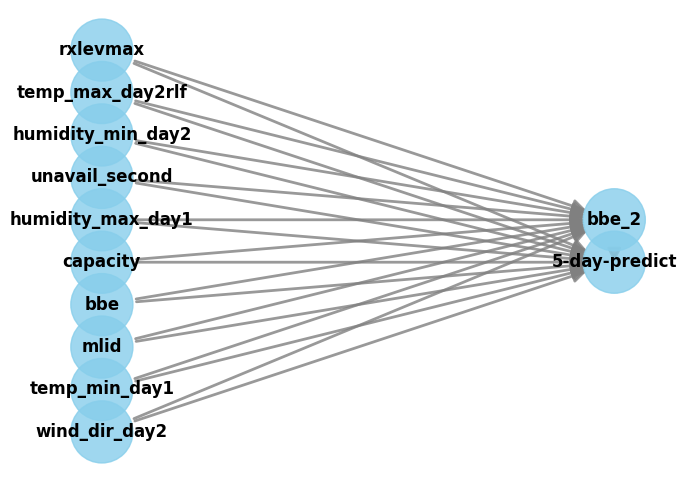

In [91]:
model.view_model()

In [79]:
identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)

In [80]:
estimate = model.estimate_effect(identified_estimand,
                                 method_name="backdoor.propensity_score_stratification")
print(estimate)
print("Causal Estimate is " + str(estimate.value))

Estimation failed! No relevant identified estimand available for this estimation method.
Causal Estimate is None


In [97]:
from dowhy.utils.plotting import plot

In [98]:
parcorr = ParCorr(significance='analytic')
pcmci_5_day_pred = PCMCI(dataframe=train_data_5_day_pred, 
                         cond_ind_test=ParCorr(),
                         verbosity=1)

correlations = pcmci_5_day_pred.run_bivci(tau_max=3, val_only=True)['val_matrix']
matrix_lags = np.argmax(np.abs(correlations), axis=2)

tau_max = 3
pc_alpha = None
pcmci_5_day_pred.verbosity = 2

results = pcmci_5_day_pred.run_pcmciplus(tau_min=0, tau_max=tau_max, pc_alpha=pc_alpha)




##
## Running Tigramite BivCI algorithm
##

Parameters:

independence test = par_corr
tau_min = 0
tau_max = 3

##
## Optimizing pc_alpha over pc_alpha_list = [0.001, 0.005, 0.01, 0.025, 0.05]
##

## pc_alpha = 0.001 (1/5):

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = par_corr
tau_min = 1
tau_max = 3
pc_alpha = [0.001]
max_conds_dim = None
max_combinations = 1



## Variable bbe_2

Iterating through pc_alpha = [0.001]:

# pc_alpha = 0.001 (1/1):

Testing condition sets of dimension 0:

    Link (bbe_2 -1) -?> bbe_2 (1/273):
    Subset 0: () gives pval = 0.98662 / val = -0.000
    Non-significance detected.

    Link (bbe_2 -2) -?> bbe_2 (2/273):
    Subset 0: () gives pval = 0.98705 / val = -0.000
    Non-significance detected.

    Link (bbe_2 -3) -?> bbe_2 (3/273):
    Subset 0: () gives pval = 0.98646 / val = -0.000
    Non-significance detected.

    Link (wind_dir_day1 -1) -?> bbe_2 (4/273):
    Subset 0: () gives pval = 0.24706 

KeyboardInterrupt: 

In [ ]:
from dowhy.utils.timeseries import create_graph_from_networkx_array

graph = create_graph_from_networkx_array(results['graph'], feature_names)

plot(graph)

In [96]:
from dowhy.utils.timeseries import create_graph_from_networkx_array
from dowhy.utils.plotting import plot
graph = create_graph_from_networkx_array(results['graph'], feature_names)

plot(graph)

NameError: name 'results' is not defined